# Exploring the dataset *Lysekil*

In [2]:
import sys
sys.path.append("../scripts")

import os
import numpy as np
import pandas as pd
import plotly.figure_factory as ff
import plotly.graph_objects as go
import seaborn as sns
import load_data, preprocessing, visualize


# Set Pandas display options to show all columns
pd.set_option('display.max_columns', None)

# Load data
df = pd.read_pickle("../data/processed/renamed_Lysekil.pkl")

## Basic visualization

In [3]:
visualize.dropdown_plot(df)

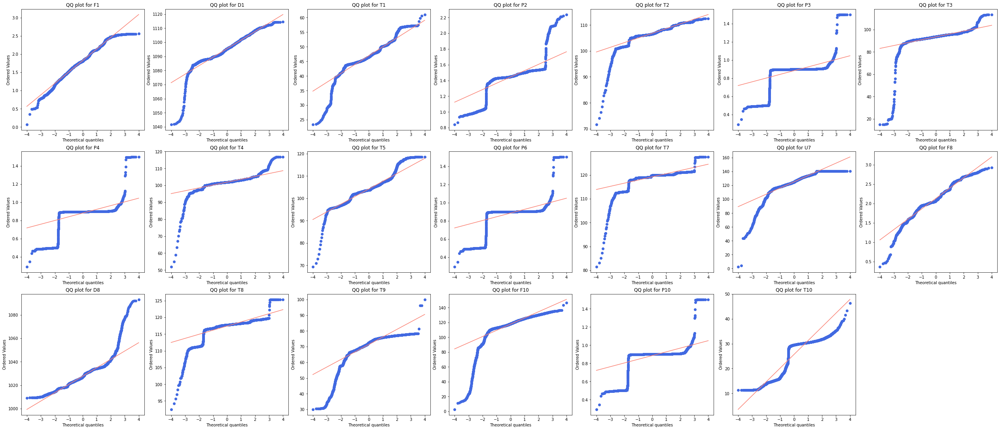

In [4]:
visualize.qq_plot_all(df.iloc[:, 1:])

## Trying to remove data points using DBSCAN

In [5]:
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler

# Select the column to analyze
col = "P6"
column_to_analyze = df[col].values.reshape(-1, 1)

# Scale the column (DBSCAN is sensitive to distances)
scaler = StandardScaler()
column_scaled = scaler.fit_transform(column_to_analyze)

# Apply DBSCAN
dbscan = DBSCAN(eps=0.01, min_samples=100)  # Adjust the parameters according to your specific needs
clusters = dbscan.fit_predict(column_scaled)

# Identify outliers (points labeled as -1)
outlier_mask = (clusters == -1)

# Remove outliers from the original DataFrame
df_no_outliers = df[~outlier_mask]
df_no_outliers[col] -= 1

fig = go.Figure()

fig.add_trace(go.Scatter(x=df["Time"], 
                        y=df[col],
                    name="Original", mode='markers', marker=dict(size=3)))

fig.add_trace(go.Scatter(x=df_no_outliers["Time"], 
                        y=df_no_outliers[col],
                    name="With outliers removed", mode='markers', marker=dict(size=3)))

fig.show()

print(len(outlier_mask))
print("Original data points:", len(df.index))
print("With outliers removed:", len(df_no_outliers.index))

21894
Original data points: 21894
With outliers removed: 20758


In [6]:
col1 = "P2"

df_no_outliers[col1] -= 1
fig = go.Figure()

fig.add_trace(go.Scatter(x=df["Time"], 
                        y=df[col1],
                    name="Original", mode='markers', marker=dict(size=3)))

fig.add_trace(go.Scatter(x=df_no_outliers["Time"], 
                        y=df_no_outliers[col1],
                    name="With outliers removed", mode='markers', marker=dict(size=3)))

fig.show()

### Trial 2

In [8]:
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler

# Select the columns to analyze (all except the first one)
columns_to_analyze = df.iloc[:, 1:].values

# Scale the data (DBSCAN is sensitive to distances)
scaler = StandardScaler()
columns_scaled = scaler.fit_transform(columns_to_analyze)

# Apply DBSCAN
dbscan = DBSCAN(eps=0.4, min_samples=5)  # Adjust the parameters according to your specific needs
clusters = dbscan.fit_predict(columns_scaled)

# Identify outliers (points labeled as -1)
outlier_mask2 = (clusters == -1)

# Remove outliers from the original DataFrame
df_no_outliers2 = df[~outlier_mask2]

# Print some information about the results
print("Number of outliers:", sum(outlier_mask2))
print("Original data points:", len(df.index))


col1 = "P6"
df_no_outliers2[col1] -= 1
fig = go.Figure()

fig.add_trace(go.Scatter(x=df["Time"], 
                        y=df[col1],
                    name="Original", mode='markers', marker=dict(size=3)))

fig.add_trace(go.Scatter(x=df_no_outliers2["Time"], 
                        y=df_no_outliers2[col1],
                    name="With outliers removed", mode='markers', marker=dict(size=3)))

fig.show()

print(len(outlier_mask2))
print("Original data points:", len(df.index))
print("With outliers removed:", len(df_no_outliers2.index))

Number of outliers: 1625
Original data points: 21894


21894
Original data points: 21894
With outliers removed: 20269


In [9]:
#col1 = "Downstream-Rich-TT1043"
col1 = "T8"


df_no_outliers2[col1] += 40
fig = go.Figure()

fig.add_trace(go.Scatter(x=df["Time"], 
                        y=df[col1],
                    name="Original", mode='markers', marker=dict(size=3)))

fig.add_trace(go.Scatter(x=df_no_outliers2["Time"], 
                        y=df_no_outliers2[col1],
                    name="With outliers removed", mode='markers', marker=dict(size=3)))

fig.show()